# Diabetic Retinopathy Detection
## Image preprocessing

The original files were preprocessed prior to training in order to speed up the file reads and enhance features.
Due to brevity, the preprocessing source code is not embedded in this notebook, you can have a look at it [here](https://github.com/rozni/uni-ml/blob/master/Cognitive_Systems_for_Health_Technology_Applications/Case_2/preprocessing.py).

All eyes were first autocontrasted, cropped and rescaled to 500px (longer side) while maintaining the aspect ratio (based on experiences of others' that image size over 500px was not very beneficial).

You can see some examples of preprocessing bellow.
Three example methods marked with an asterisk (\*) turned out to be the most useful ones for our models (last three).

In [1]:
import os

import numpy as np
import pandas as pd

import cv2 as cv

import matplotlib.pyplot as plt

# source: https://github.com/rozni/uni-ml/blob/master/Cognitive_Systems_for_Health_Technology_Applications/Case_2/preprocessing.py
# revision: 5c883344f8095bb8bf2e0fbe9091b05be954f03d
import preprocessing as prep

In [2]:
BASE_DIR = '/Share/dr/'

# updated labels
labels_df = pd.read_csv(os.path.join(BASE_DIR, 'labels.csv'))

*Note:*
For practicallity, file names were changed so that the class is prepended before the original name, i.e., 10_left.jpeg becomes 0_10_left.jpeg, 23529_left.jpeg becomes 2_23529_left.jpeg, some level 3 would be prepended with 3_, etc. This made it easier to manipulate the files and to immediately infer the level of symptoms.

In [3]:
print('The examples will be shown on following images:')
sample_images = labels_df.sample(n=20)
sample_images

The examples will be shown on following images:


,image,level,file_name,class
28609,36232_right,2,2_36232_right.jpeg,symptoms
15769,19770_right,0,0_19770_right.jpeg,nosymptoms
25631,32427_right,2,2_32427_right.jpeg,symptoms
16736,21013_left,0,0_21013_left.jpeg,nosymptoms
16930,21234_left,0,0_21234_left.jpeg,nosymptoms
27961,35414_right,0,0_35414_right.jpeg,nosymptoms
19459,24577_right,0,0_24577_right.jpeg,nosymptoms
22985,29034_right,0,0_29034_right.jpeg,nosymptoms
28668,36314_left,0,0_36314_left.jpeg,nosymptoms
28894,36588_left,1,1_36588_left.jpeg,symptoms


In [4]:
# don't mind this cell, it's just little helpers :)

def show_images(imgs, labels=None, cols=4, cmap=None):
    """Show given images in a grid"""
    rows = int(np.ceil(len(imgs) / cols))
    f, ax = plt.subplots(
        rows,
        cols,
        figsize=(20, rows*(20//cols)),
        squeeze=True
    )
    
    if labels is None:
        labels = range(len(imgs))
        
    for index, (img, label) in enumerate(zip(imgs, labels)):
        a = ax.flat[index]
        a.imshow(img, cmap=cmap)
        a.set_title(label)
        a.axis('off')
        
    plt.tight_layout()
    plt.show()


def load_images(paths, post_img_load=None):

    imgs = []
    for img_path in paths:
        img = cv.imread(img_path, cv.IMREAD_COLOR)
        
        if post_img_load:
            img = post_img_load(img)
            
        imgs.append(img)
        
    return imgs

In [5]:
original_imgs = load_images(
    BASE_DIR + 'orig/train/' + sample_images.image + '.jpeg',
    lambda img: cv.cvtColor(img, cv.COLOR_BGR2RGB)
)

# 1st round of preprocessed images - autocontrasted, cropped, resized
imgs = load_images(
    BASE_DIR + '500_cropped_contrast/' + sample_images.file_name,
    lambda img: cv.cvtColor(img, cv.COLOR_BGR2RGB)
)

Original images


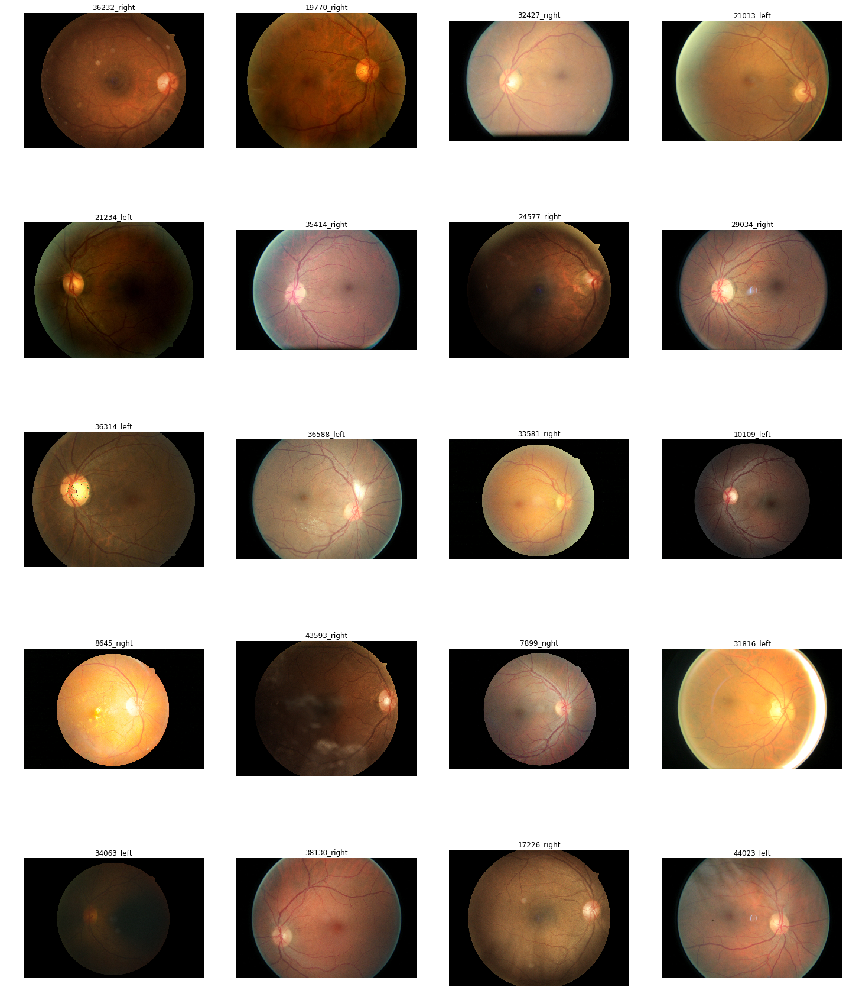

In [6]:
print('Original images')
show_images(original_imgs, sample_images.image)

Basic preprocessing - contrast, cropping, resizing - all following preprocessing is based on this


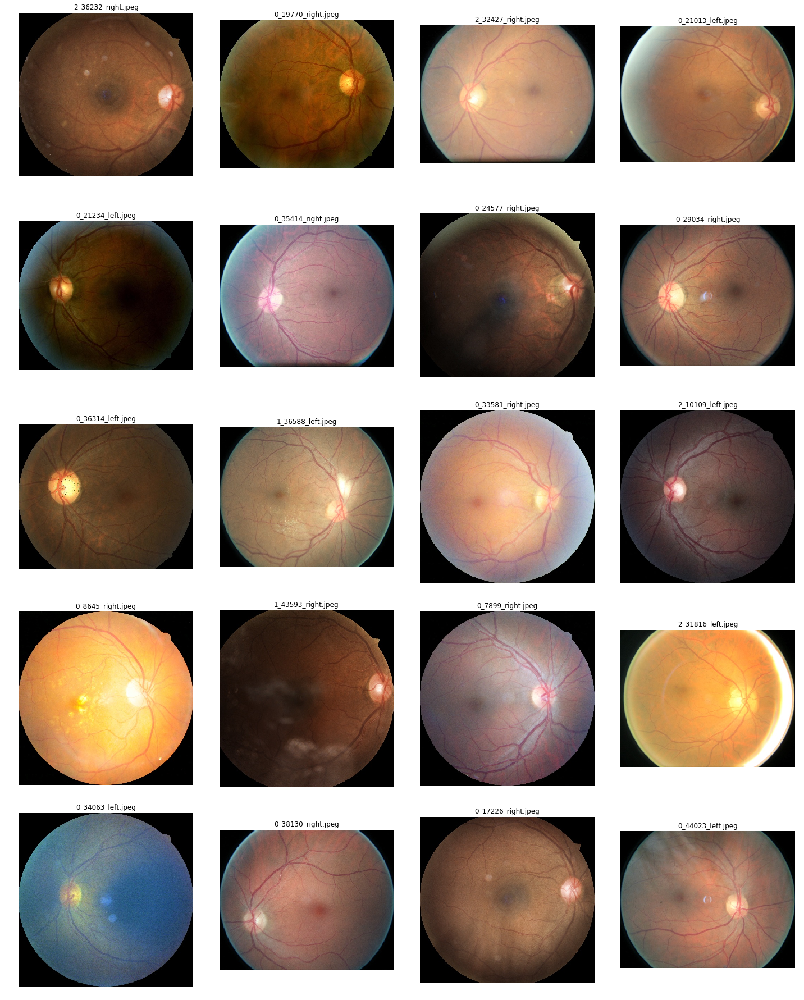

In [7]:
print('Basic preprocessing - contrast, cropping, resizing - all following preprocessing is based on this')
show_images(imgs, sample_images.file_name)

Masked to 90% of eyes radius (to remove the boundary), padded to square


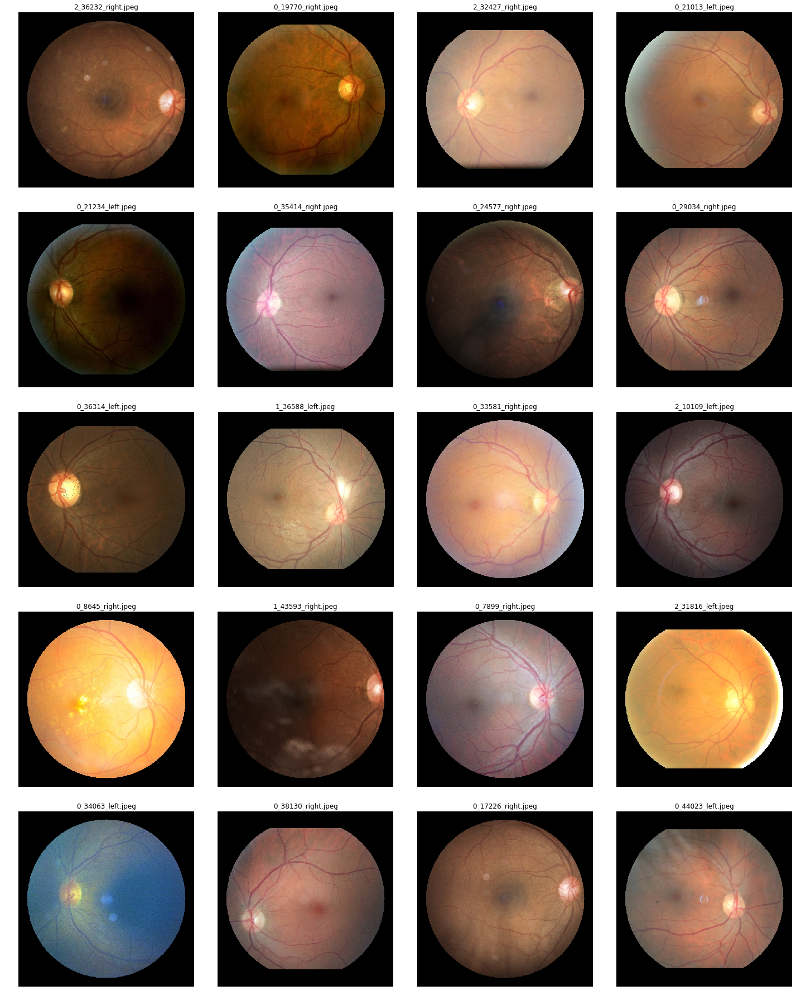

In [8]:
print('Masked to 90% of eyes radius (to remove the boundary), padded to square')
show_images([prep.common.mask_pad(img.copy(), 0) for img in imgs], sample_images.file_name)

Equalized colors (histogram), masked, padded


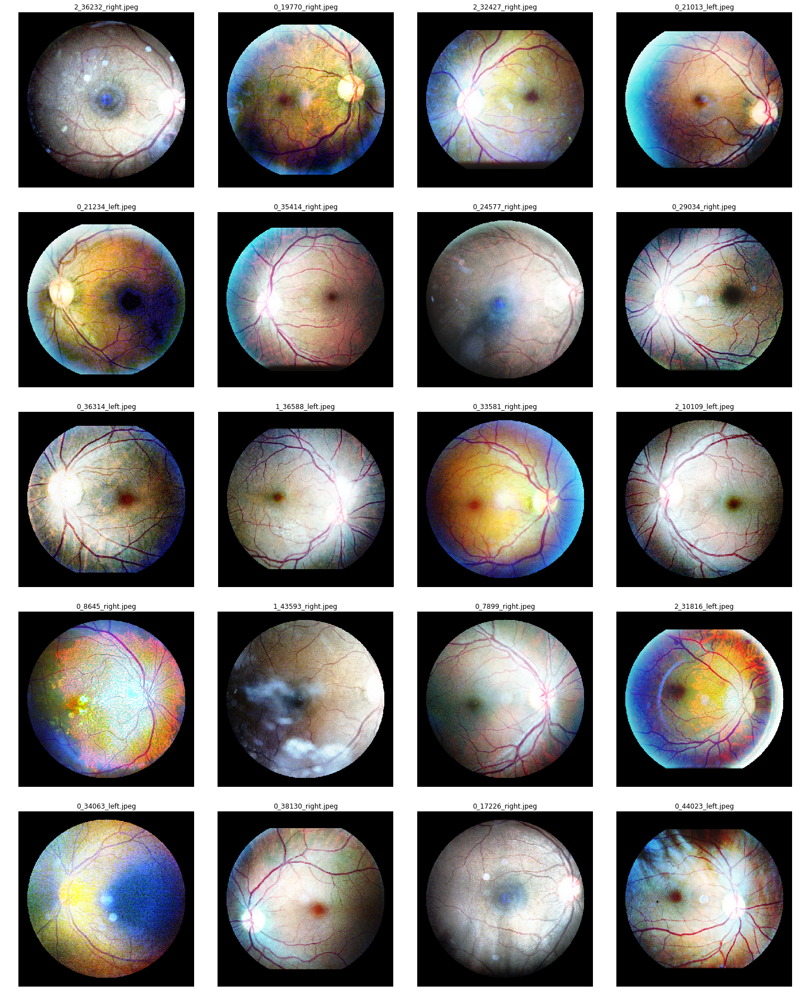

In [9]:
print('Equalized colors (histogram), masked, padded')
show_images([prep.common.equalize_0_mask_pad(img.copy()) for img in imgs], sample_images.file_name)

Contrast limited adaptive histogram equalization (CLAHE), masked, padded


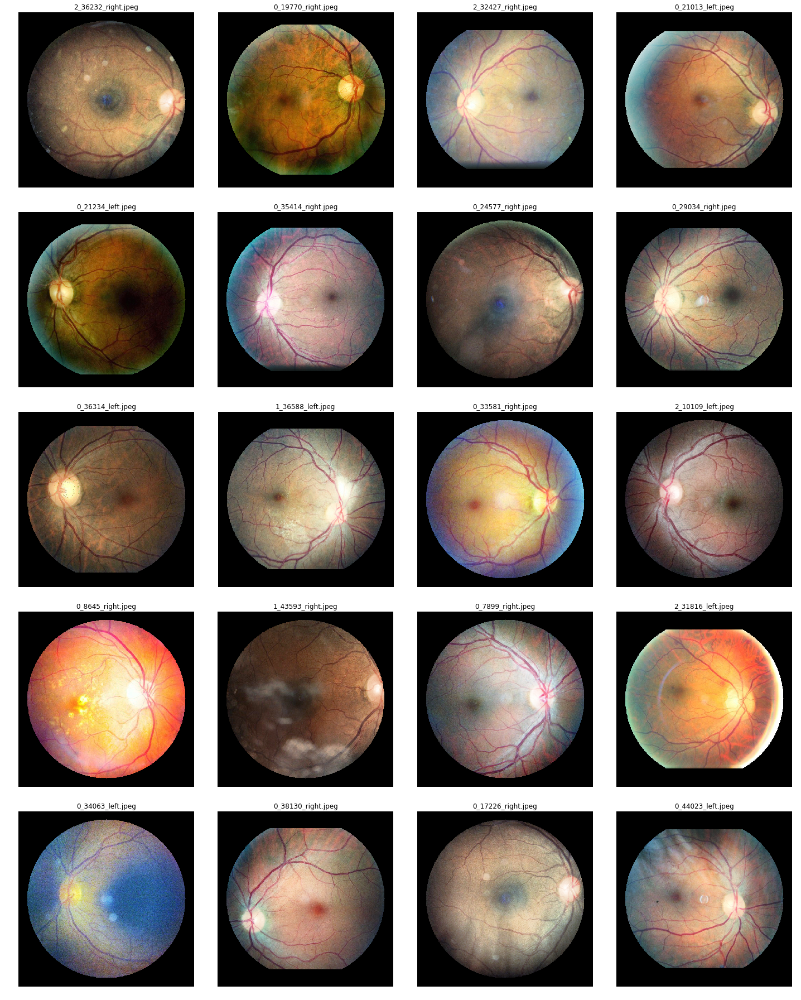

In [10]:
print('Contrast limited adaptive histogram equalization (CLAHE), masked, padded')
show_images([prep.common.clahe_0_mask_pad(img.copy()) for img in imgs], sample_images.file_name)

Equalized, masked and padded with 128 level gray (near global average color of the dataset)


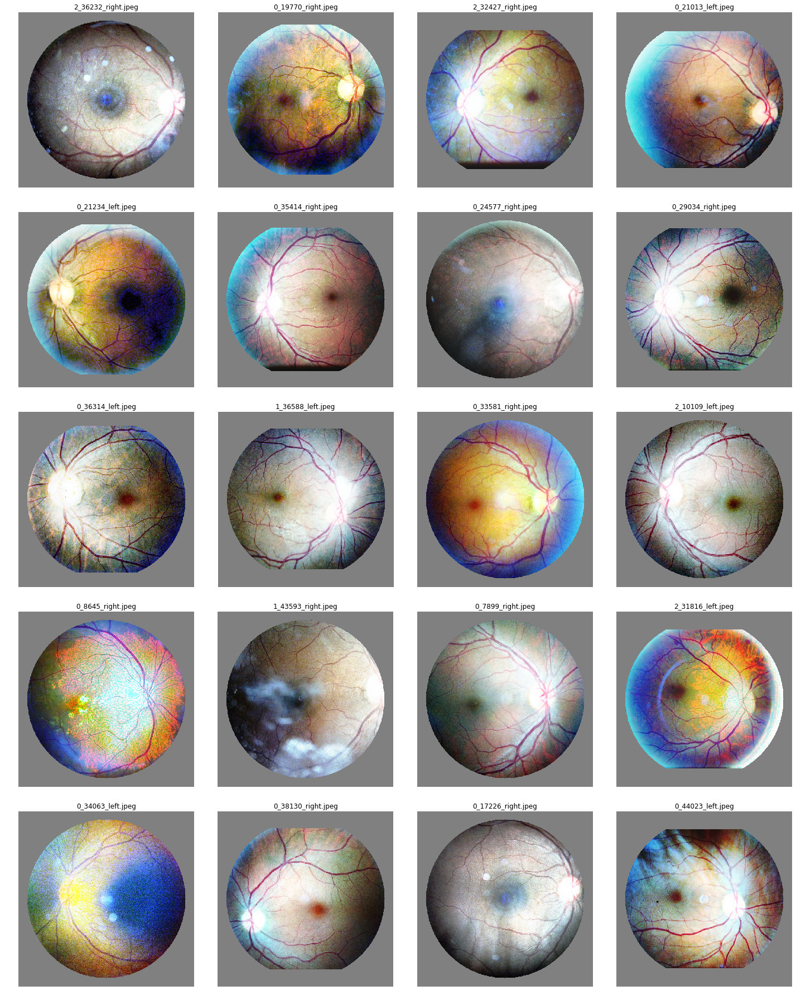

In [11]:
print('Equalized, masked and padded with 128 level gray (near global average color of the dataset)')
show_images([prep.common.equalize_128_mask_pad(img.copy()) for img in imgs], sample_images.file_name)

* CLAHE, masked and padded with 128 level gray


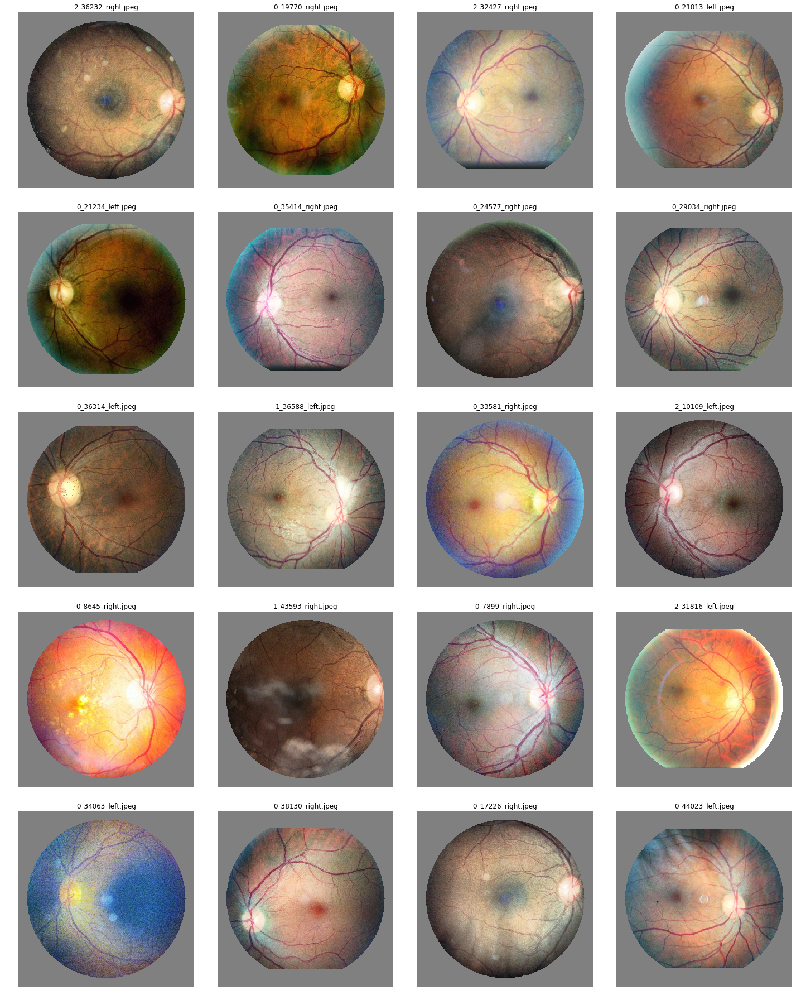

In [12]:
print('* CLAHE, masked and padded with 128 level gray')
show_images([prep.common.clahe_128_mask_pad(img.copy()) for img in imgs], sample_images.file_name)

* Removed local average color, masked and padded with 128 level gray
  (preprocessing step inspired by the winner of the competition - Benjamin Graham,
  visit https://www.kaggle.com/c/diabetic-retinopathy-detection/discussion/15801 for more information)


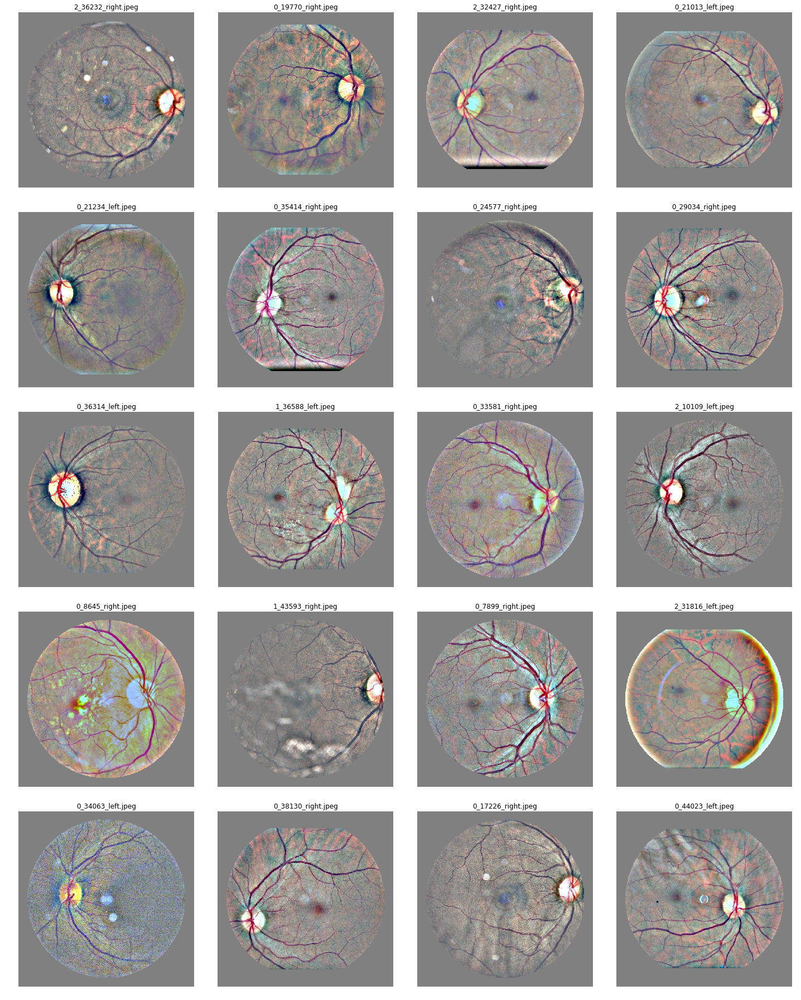

In [13]:
print(
    '* Removed local average color, masked and padded with 128 level gray\n'
    '  (preprocessing step inspired by the winner of the competition - Benjamin Graham,\n'
    '  visit https://www.kaggle.com/c/diabetic-retinopathy-detection/discussion/15801 for more information)'
)
        
show_images([prep.common.graham_128_mask_pad(img.copy()) for img in imgs], sample_images.file_name)

* CLAHE, converted to grayscale, masked and padded with 128 level gray


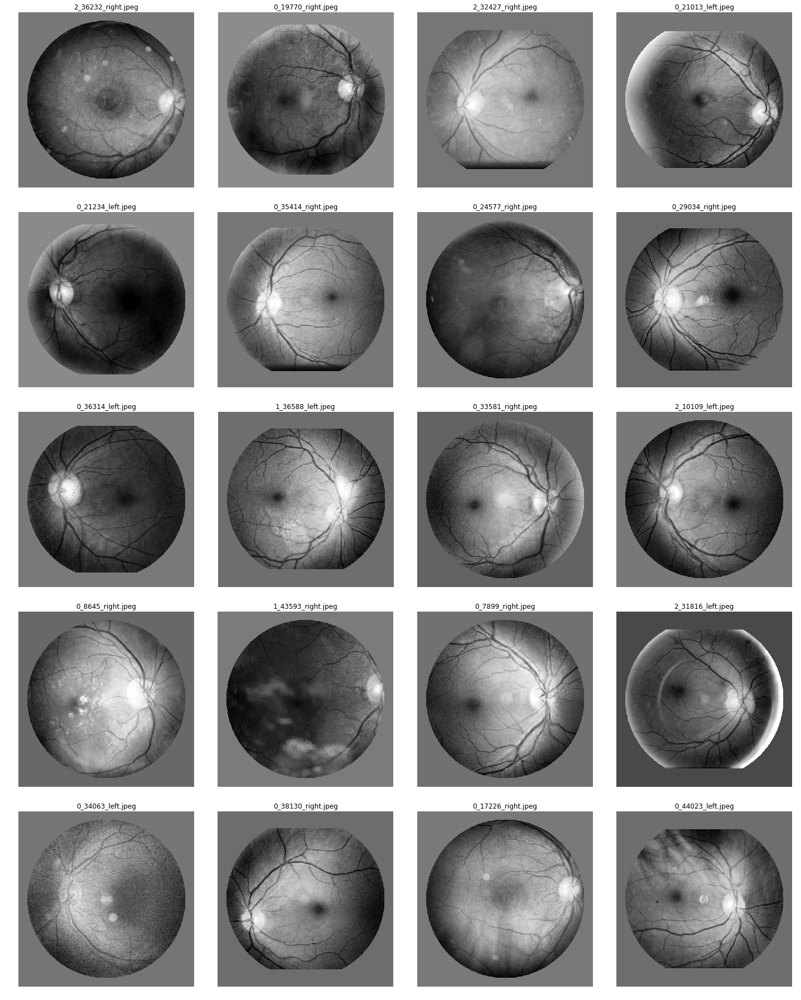

In [14]:
print('* CLAHE, converted to grayscale, masked and padded with 128 level gray')
process = lambda img: cv.cvtColor(prep.common.clahe_128_mask_pad(img.copy()), cv.COLOR_BGR2GRAY)
show_images([process(img) for img in imgs], sample_images.file_name, cmap='gray')

Neural networks are able to change colorspaces on their own, however, training using a grayscale image was about twice as fast and was able to pick up features earlier, we have not found out when this advantage starts to diminish.
We also tried conveting to the [YCrCb colorspace](https://en.wikipedia.org/wiki/YCbCr), which seemed to pick up on features marginally earlier compared to RGB, yet that might have been only due to lucky initializations.